**C7082-Techniques in Machine learning and AI**

**Student Id**

22302900

**Github link**

https://github.com/kksam2705/Techniques-in-ML-and-AI.git

**Background**

  The aim of this project is to detect the animals that are living in the Aquariums.we will draw the bounding boxes and detect the classes of the animals.
 For detection we are going to use the YOLOV5 model.you only look once is the meaning of YOLOV5 is an alogorithm that uses neural networks to provide real time object detection.it will detect between various objects in digital images and videos.And we also use tensorflow to display our graphs.

 **Objective**

Climate change made huge differnce in degradation of Aquatic animals and coral reefs.The preservation of coral reefs and marine life depends on underwater health monitoring. In this project, we'll use computer vision and deep learning to create an aquarium object recognition system.


**Methods**

**Data source**

https://public.roboflow.com/object-detection/aquarium
 
** Dataset Details**

This dataset consists of 638 photos gathered by Roboflow from two aquariums in the United States.The National Aquarium in Baltimore and the Henry Doorly Zoo in Omaha (both on October 16, 2020). (November 14, 2020). This dataset was collected to identify objects. There are seven classes listed below.



1. Fish
2. stingray
3. jellyfish
4. penguin
5. shark
6. puffin
7. starfish

For training this model we are going to use train and split method.That means for train we use 70% of images and for split 20% images and for validation 10% of images.

The reason for using train-split method is used to estimate the performance of the Machine learning alogirthams that are applicable for predication based algorithams and applications.This method is fast and easy procedure to perform such that we can compare our own machine learning model results to machine results.

In [ ]:
#clone YOLOv5 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")


Cloning into 'yolov5'...
remote: Enumerating objects: 14995, done.
remote: Total 14995 (delta 0), reused 0 (delta 0), pack-reused 14995
Receiving objects: 100% (14995/14995), 14.02 MiB | 31.54 MiB/s, done.
Resolving deltas: 100% (10286/10286), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.0/184.0 KB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 48.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.5/46.5 KB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.5/138.5 KB 16.0 MB/s eta 0:00:00
Setup complete. Using torch 1.13.1+cu116 (Tesla T4)


**create our database**

We must put together a dataset of typical photos with bounding box annotations surrounding the things we wish to detect in order to train our custom model. Additionally, we require a dataset in YOLOv5 format.

For this we are using the roboflow.Roboflow is an open AI that will annotate the images and draw bounding boxes.it makes us easy to train our model.

In [ ]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [ ]:
# set up environment to save our dataset
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
#import the dataset to google colab
!pip install roboflow
from roboflow import Roboflow
rf = Roboflow(api_key="TypZZgpMSpKK7oNxPV26")
project = rf.workspace("kk-fgzul").project("fish-x35tq")
dataset = project.version(1).download("yolov5")



Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/fish-1 in yolov5pytorch:: 100%|██████████| 1286/1286 [00:00<00:00, 2274.09it/s]


**Develop our model**

1. img: define the input picture size using img.
2. batch: Determine the batch size.
3. epochs: specify how many training epochs there are.
4. data: The dataset location for our project has been stored.
5. Weights: Define a starting path for weights. transmit knowledge gained. In this case, we pick the standard COCO pretrained checkpoint.
6. cache: pictures should be cached for quicker training.

In [ ]:
!python train.py --img 416 --batch 16 --epochs 400 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/fish-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=400, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-71-gc442a2e Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, 

**Evaluate Custom YOLOv5 Detector Performance**

 Using tensorboard we are going to evaluate our model.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [ ]:
# Run inference with trained weights
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/fish-1/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-71-gc442a2e Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7029004 parameters, 0 gradients, 15.8 GFLOPs
image 1/63 /content/datasets/fish-1/test/images/IMG_2298_jpeg_jpg.rf.6fc31257f43a6f3bb3c4f7e44bb966d0.jpg: 416x416 8 puffins, 8.3ms
image 2/63 /content/datasets/fish-1/test/images/IMG_2304_jpeg_jpg.rf.036da64118c64326b72acfc230a0b48e.jpg: 416x416 14 penguins, 9.2ms
image 3/63 /content/datasets/fish-1/test/images/IMG_2311_jpeg_jpg

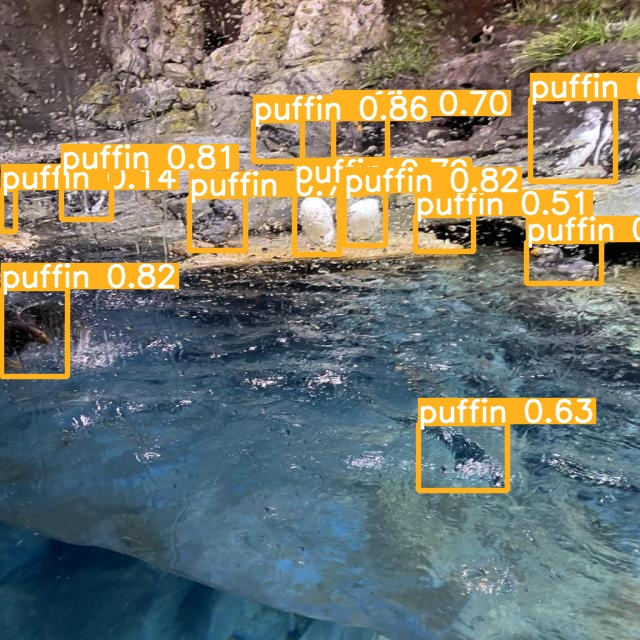

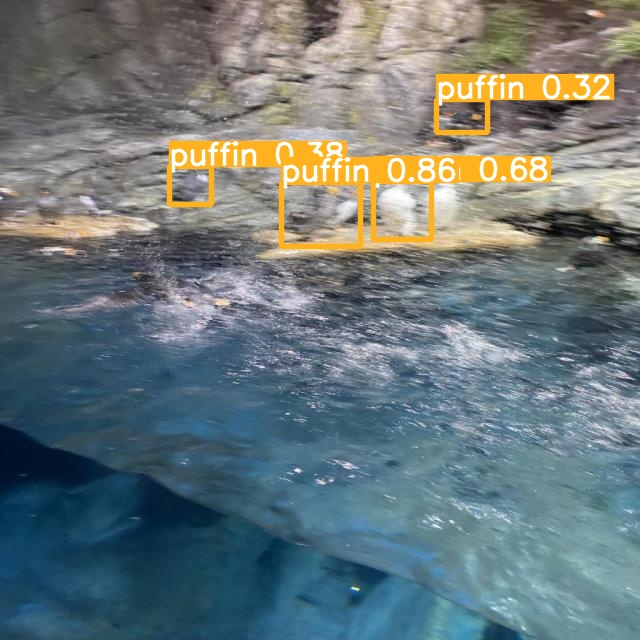

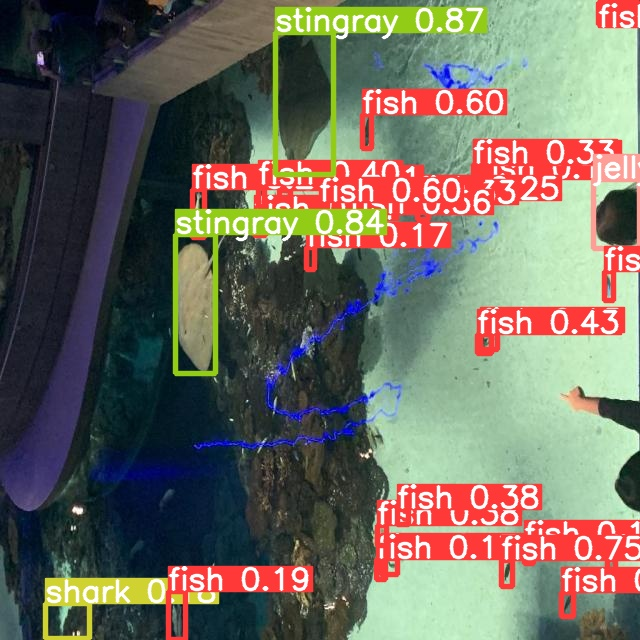

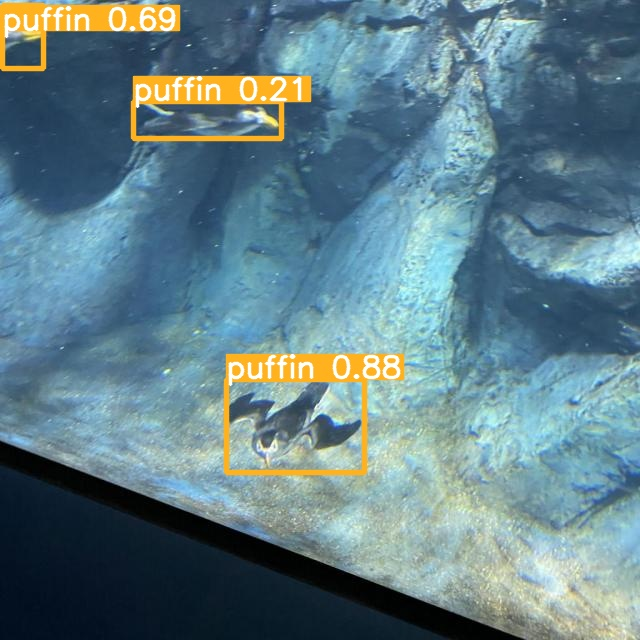

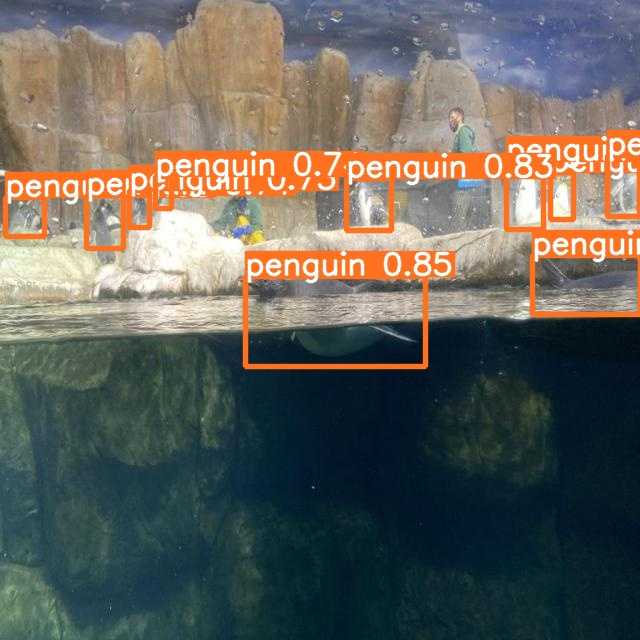

...

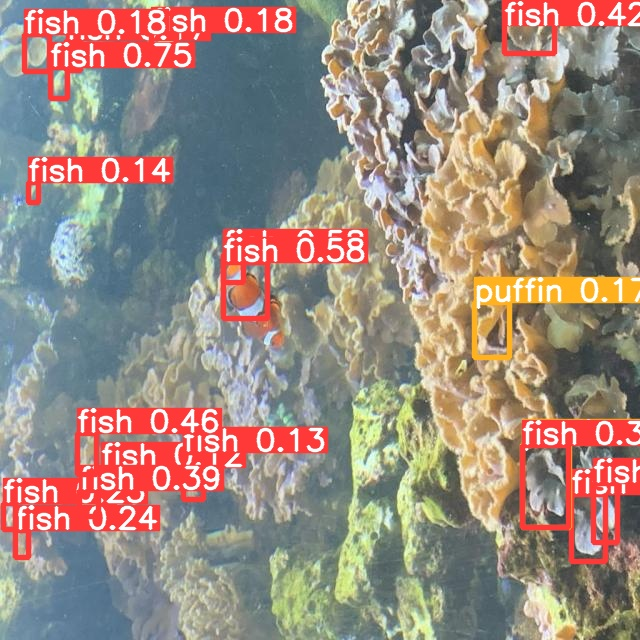

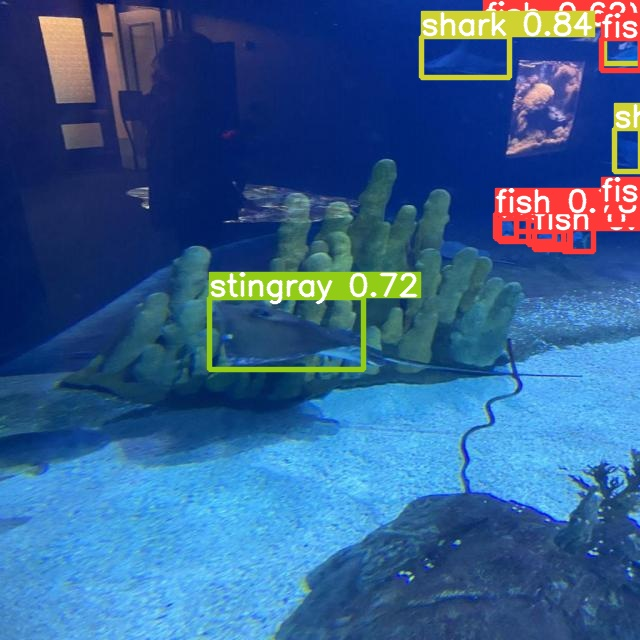

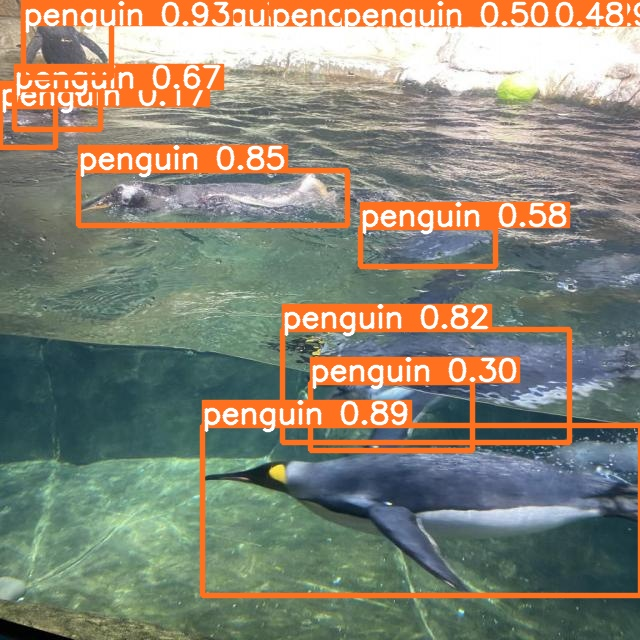

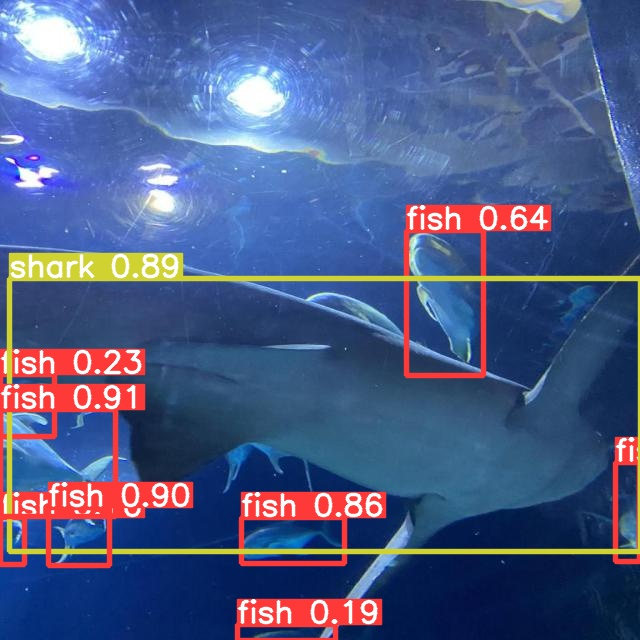

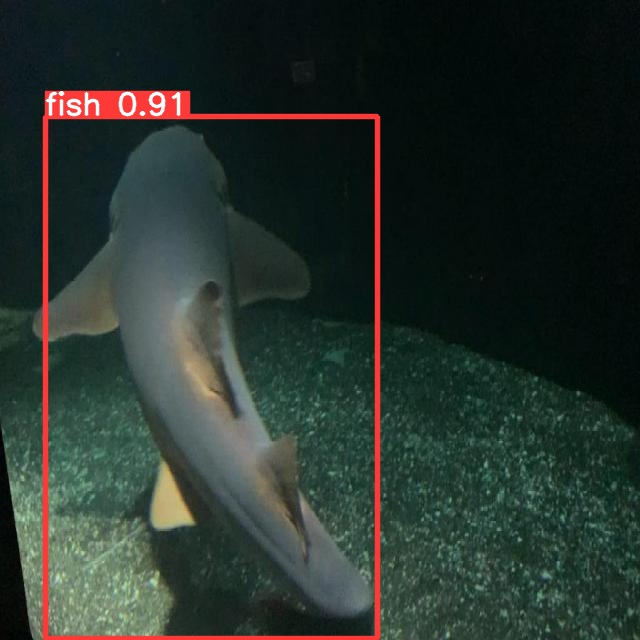

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

**Results** 

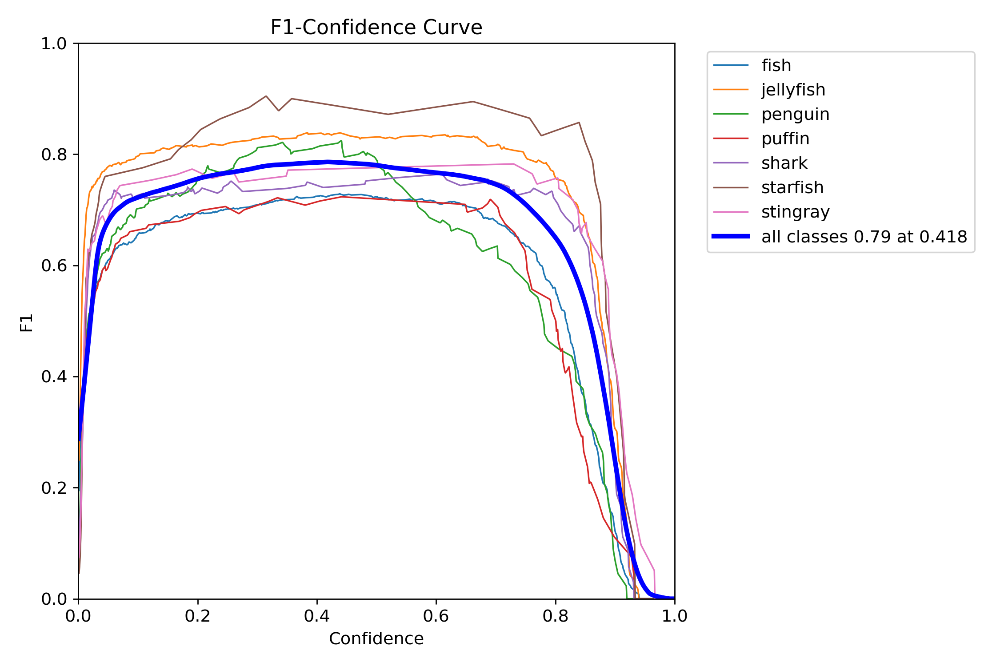

In [ ]:
#Display the graphs for inference
from IPython.display import Image, display
display(Image('/content/yolov5/runs/train/exp/F1_curve.png'))


From the F1-confidence curve, the confidence value that optimizes the precision and recall is 0.418.In many cases higher confidence value is desirable.F1 curve is basically how well our detector is performed.

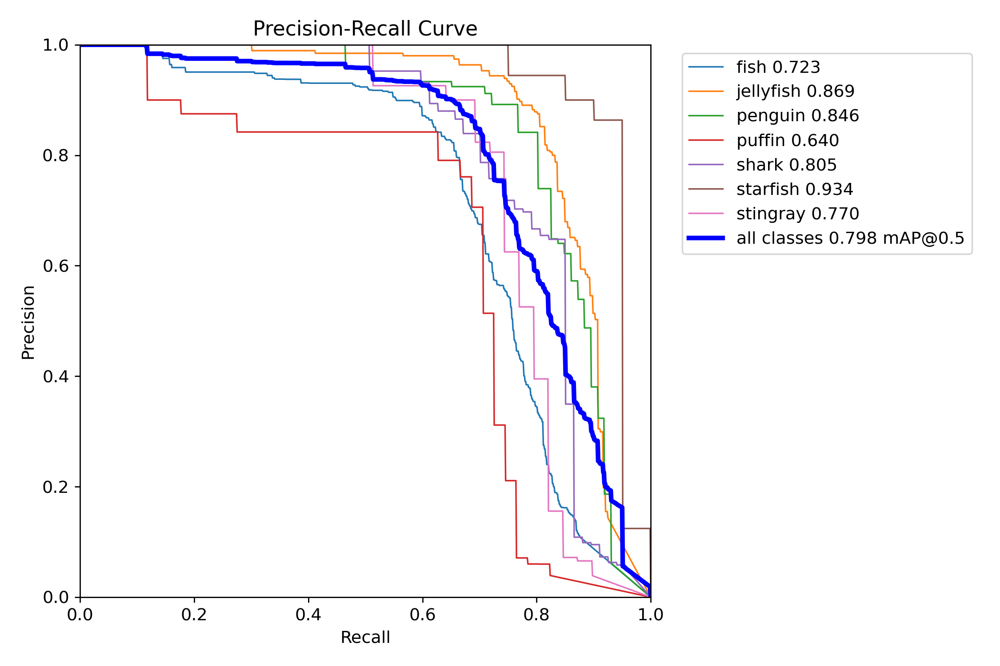

In [ ]:
display(Image('/content/yolov5/runs/train/exp/PR_curve.png'))

The precision recall curve shows the tradeoff between precision and recall of different threshold.A high area under the curve represents the high recall and high precision,high precision means low false positive rate, high recall relates to a low false negative rate. our curve as close as possible to the top right corner that means our model performed well.

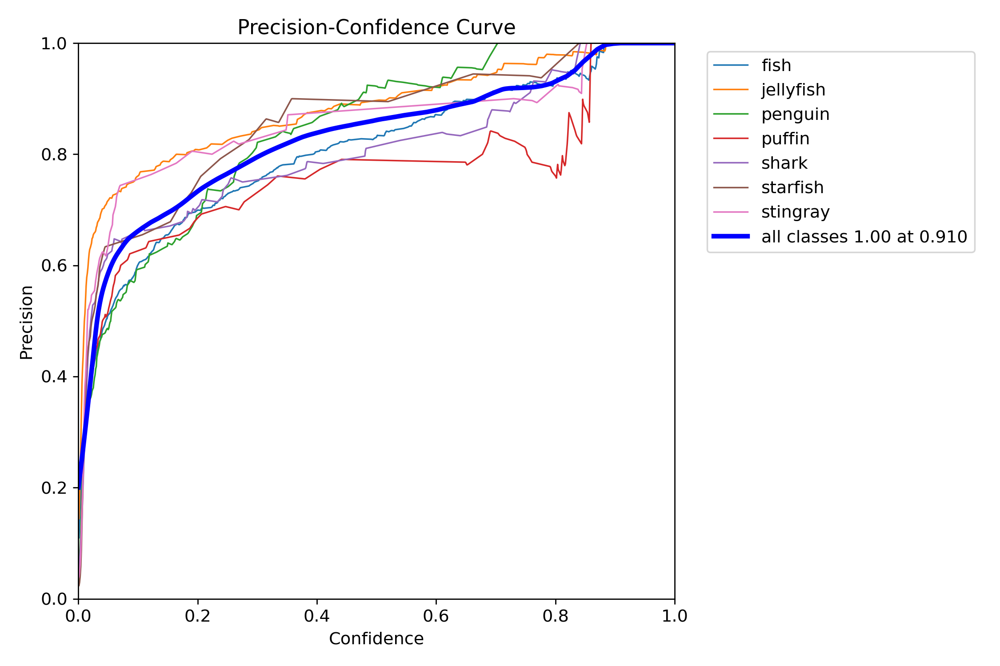

In [ ]:
display(Image('/content/yolov5/runs/train/exp/P_curve.png'))

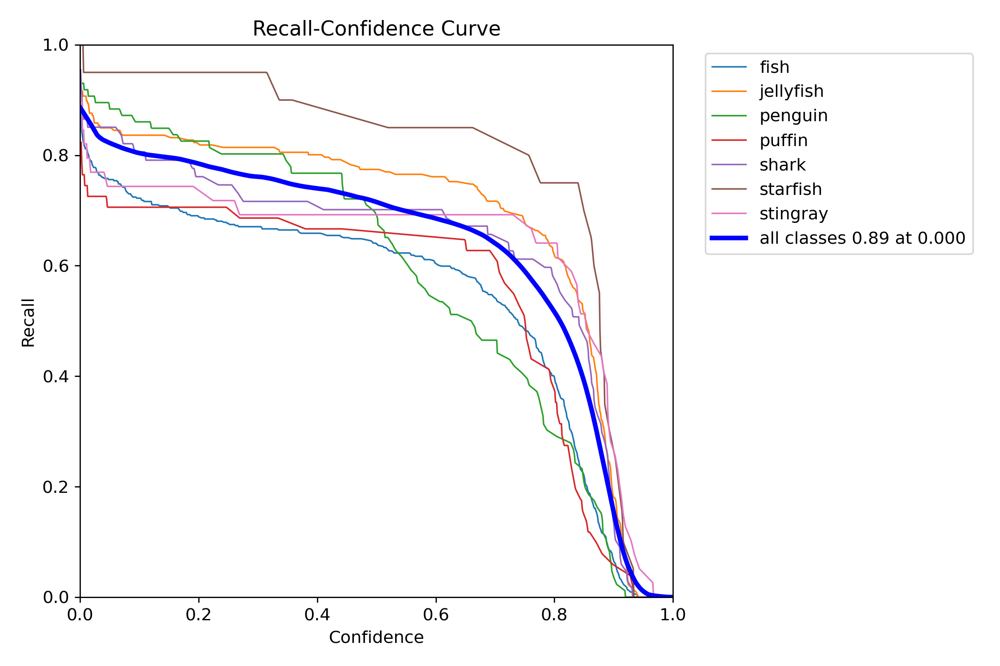

In [ ]:
display(Image('/content/yolov5/runs/train/exp/R_curve.png'))

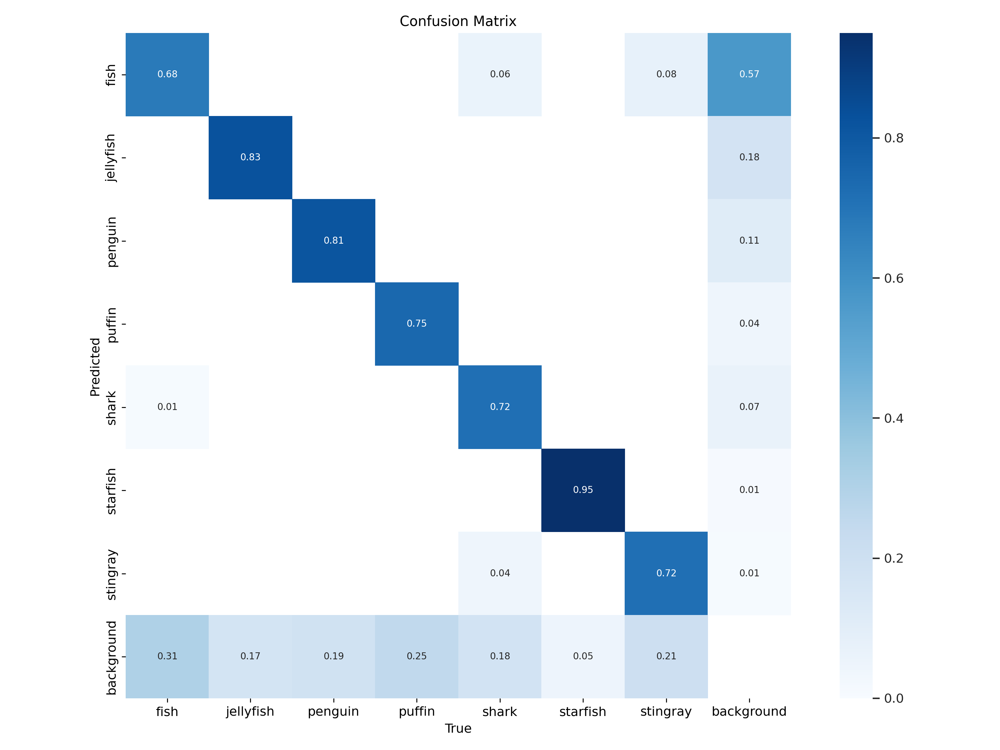

In [ ]:
display(Image('/content/yolov5/runs/train/exp/confusion_matrix.png'))

Confusion matrix is a summary of prediction results on classification problem.The number correct and incorrect predictions are summarized with count values and broken down by each class.The highest prediction is for star fish which is 0.95% and jellyfish 0.83% and penguin 0.81% and so on.

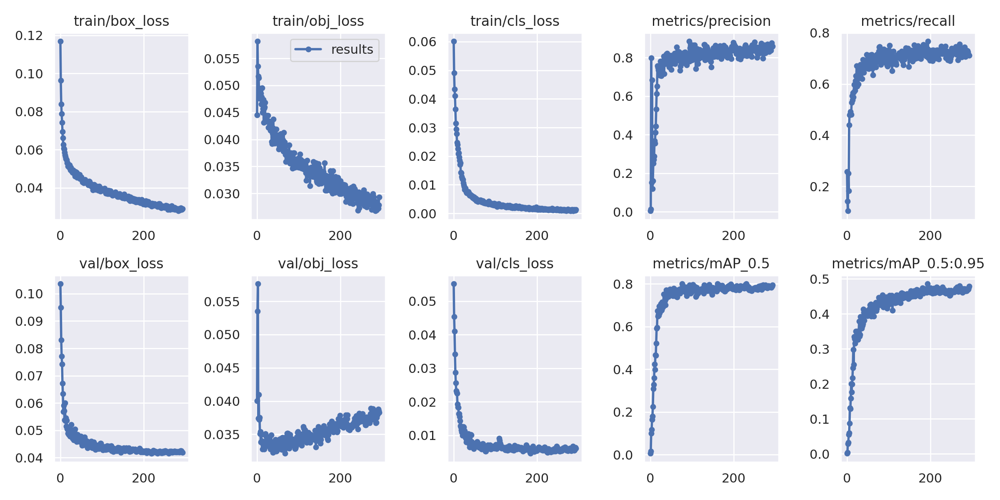

In [ ]:
display(Image('/content/yolov5/runs/train/exp/results.png'))

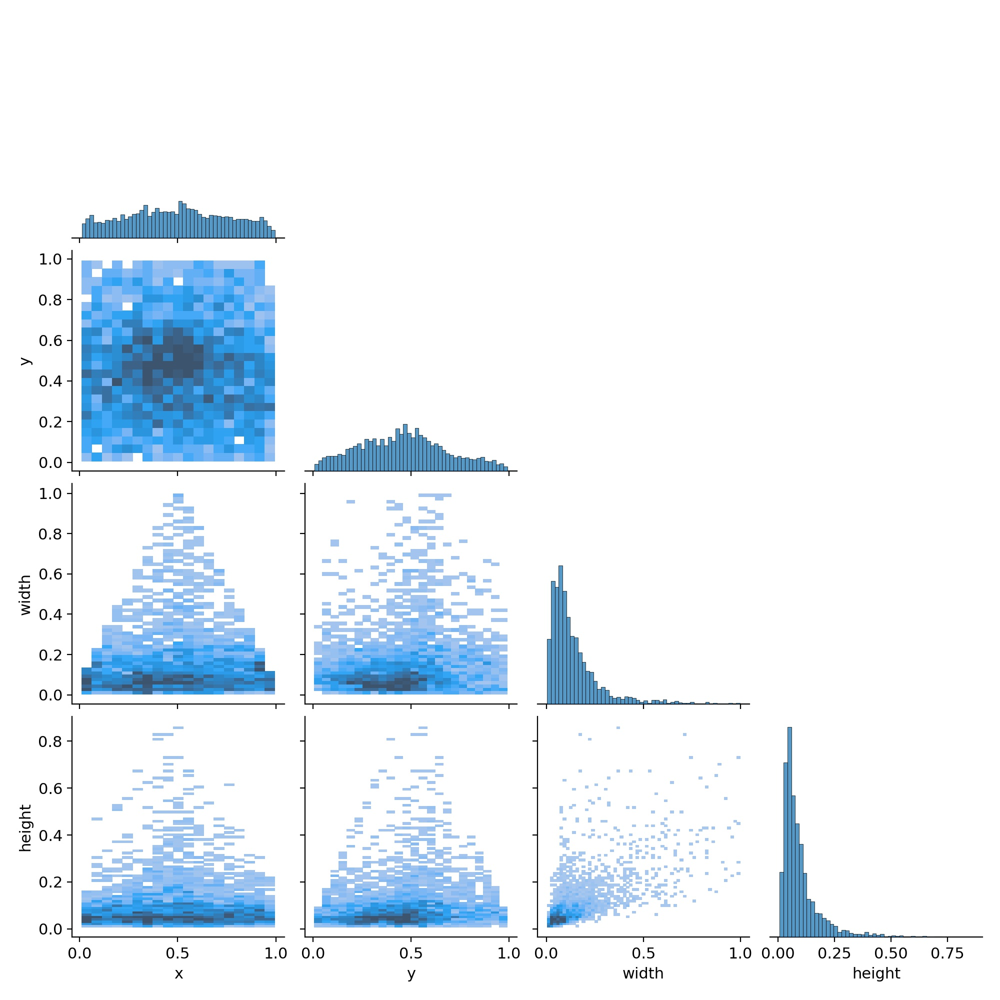

In [ ]:
display(Image('/content/yolov5/runs/train/exp/labels_correlogram.jpg'))

A correlogram or correlation matrix allows to analyse the relationship between each pair of numeric variables of a dataset.A realtionship between each pair is visualized by scatterplot.our correlogram performed well beacuse of high scattering.

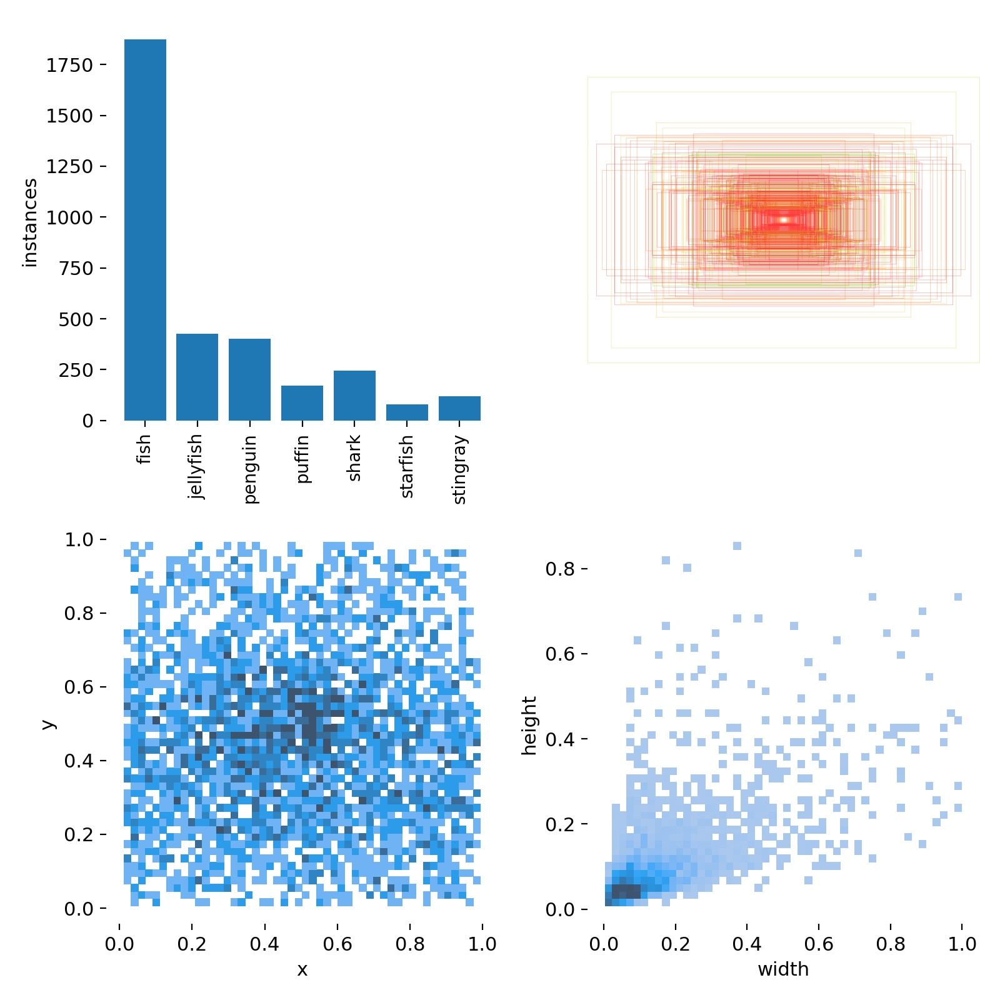

In [ ]:
display(Image('/content/yolov5/runs/train/exp/labels.jpg'))

**Discussion**

We sucessfully trained our object detection using YOLOV5 for Aquariums.Aquatic animals play an important role for the environment and humans daily usage.The importance of aquatic animals come from the part of that they provide food,medicine,Energy shelter and raw materials that are used for our daily life.By using this computer vision and Deep learning  model we can monitor the sea animals and keep the population under check and protect them from Extinction. 

**Interpretation**

I trained 400 epochos for the best results but my model trained only upto 293 epochos because the best results are observed at epochos 193.I thought best result will be observed between 300 to 400.

Mean average precision is commonly used to analyze the performanace of object detection models.
 so MAP(mean avearge precision) for the overall model is 0.79% which is pretty good and our model performed very well.

 Mean average precision by classes

1. Fish      0.72%
2. jellyfish 0.86%
3. penguin   0.84%
4. puffin    0.64
5. shark     0.80%
6. starfish  0.93%
7. stingray  0.77%

The best performed class is starfish which is 0.93% and least performed class is puffin 0.64%.

**Literature citation**

https://github.com/ultralytics/yolov5

https://app.roboflow.com/kk-fgzul

https://blog.roboflow.com/yolov5-improvements-and-evaluation/

https://blog.roboflow.com/mean-average-precision/#what-is-the-precision-recall-curve

https://github.com/ultralytics/yolov5/wiki/Train-Custom-Data

https://colab.research.google.com/github/roboflow-ai/yolov5-custom-training-tutorial/blob/main/yolov5-custom-training.ipynb

https://pytorch.org/hub/ultralytics_yolov5/#:~:text=YOLOv5%20%F0%9F%9A%80%20is%20a%20family,Model